In [2]:
##
import numpy as np
import pandas as pd
import itertools
from collections import defaultdict
import random
import json
import networkx as nx
import pylab as plt
import matplotlib.transforms as mtransforms
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.cm as cm
from scipy.stats import bootstrap
import geopandas
import geopandas as gpd
path = '/home/qiuyang/workplace/world_map_drawing/raw_data/'
## dots
### city latitude and longitude
df_city_pa = pd.read_csv(path+'ScienceCityLatLong.csv')

## edges
### city dots that contain five or more onsite teams
citynodes = pd.read_csv(path+'ScienceDisruptionCityNodes.csv')
### city edges that contain five or more remote teams
city_path = {}
EC = {}
main_city = {}
with open(path+'ScienceDisruptionCityEdges.txt','r',encoding='utf-8') as f:
    for line in f:
        line = line.strip('\n').split('\t')

        pair = tuple(line[0].split('&'))

        color = line[1]
        city_path[pair] = [list(map(float,line[3].split(','))),list(map(float,line[4].split(',')))]

        EC[pair] = color
        if int(line[2]) == 1:
            main_city[pair] = 1

# # 指定保存字典的文件路径
# file_path = 'city_path.json'

# city_path_str_keys = {str(pair): values for pair, values in city_path.items()}

# # 将字典序列化为 JSON 格式的字符串
# json_string = json.dumps(city_path_str_keys, indent=2)  # indent 参数是可选的，使文件更易读

# # 将 JSON 字符串写入文件
# with open(file_path, 'w') as json_file:
#     json_file.write(json_string)

DC = dict(zip(list(citynodes['City']),list(citynodes['Color'])))

CLla = dict(zip(list(df_city_pa['City']),list(df_city_pa['Lat'])))

CLln = dict(zip(list(df_city_pa['City']),list(df_city_pa['Lng'])))



CL_paper = {c:(CLln[c],CLla[c]) for c in CLla}

## dots
### city latitude and longitude
df_city_pt = pd.read_csv(path+'TechnologyCityLatLong.csv')
CLla_pt = dict(zip(list(df_city_pt['City']),list(df_city_pt['Lat'])))
CLln_pt = dict(zip(list(df_city_pt['City']),list(df_city_pt['Lng'])))
CL_patent = {c:(CLln_pt[c],CLla_pt[c]) for c in CLla_pt}
## edges
### city dots that contain five or more onsite teams
citynodes = pd.read_csv(path+'TechnologyDisruptionCityNodes.csv')
DC_pt = dict(zip(list(citynodes['City']),list(citynodes['Color'])))
### city edges that contain five or more remote teams
city_path_pt = {}
EC_pt = {}
main_city_pt = {}
with open(path+'TechnologyDisruptionCityEdges.txt','r',encoding='utf-8') as f:
    for line in f:
        line = line.strip('\n').split('\t')
        pair = tuple(line[0].split('&'))
        color = line[1]
        city_path_pt[pair] = [list(map(float,line[3].split(','))),list(map(float,line[4].split(',')))]
        EC_pt[pair] = color
        if int(line[2]) == 1:
            main_city_pt[pair] = 1

###### Figure 1a-d

color_dict = {'Africa':'#070707', 'Antarctica':'#070707', 'Asia':'#070707',
              'Europe':'#070707', 'North America':'#070707',
              'Oceania':'#070707', 'Seven seas (open ocean)':'#070707',
              'South America':'#070707'}

city_gdf_pa = geopandas.GeoDataFrame(
    df_city_pa, geometry=geopandas.points_from_xy(df_city_pa.Lng, df_city_pa.Lat))
city_gdf_pt = geopandas.GeoDataFrame(
    df_city_pt, geometry=geopandas.points_from_xy(df_city_pt.Lng, df_city_pt.Lat))

# print(city_gdf_pa)

alp = 0.25
lw_ = 1
cs = {
    'red':'#d62728',
    'blue':'#1f77b4'
}


fc = "#404040"#"#333333"#"#666666"#262626
# gdf = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))




In [3]:
from scipy.interpolate import make_interp_spline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm
prop = fm.FontProperties(fname='/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')
# gdf = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))
gdf = gpd.read_file('/home/qiuyang/workplace/world_map_drawing/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp')
a = []
# for column in gdf.columns:
#     print(column)


In [4]:
import numpy as np
import pandas as pd
import itertools
from collections import defaultdict
import random
import json
import networkx as nx
import pylab as plt
import matplotlib.transforms as mtransforms
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.cm as cm
from scipy.stats import bootstrap


# 指定读取字典的文件路径
file_path = r'/home/qiuyang/workplace/world_map_drawing/city_path.json'

# 从 JSON 文件中读取字符串
with open(file_path, 'r') as json_file:
    json_string = json_file.read()

# 将 JSON 字符串解析为字典
city_path_str_keys = json.loads(json_string)

# 转换字符串键为元组键
city_path = {tuple(eval(pair_str)): values for pair_str, values in city_path_str_keys.items()}

file_path2 = r'/home/qiuyang/workplace/world_map_drawing/capital_location1.json'

# 用于存储每行解析后的字典的列表
capital_location = []
count = 0
# 逐行读取JSON文件并解析为字典
with open(file_path2, 'r') as file:
    for line in file:
        count = count+1
        try:
            # 解析JSON字符串为字典
            data = json.loads(line)
            capital_location.append(data)
        except json.JSONDecodeError as e:
            print(f"Error decoding JSON: {e}")
            print(count)

def simple_distance(lat1, lon1, lat2, lon2):
    # 计算纬度和经度的差值的绝对值之和
    delta_lat = abs(lat1 - lat2)
    delta_lon = abs(lon1 - lon2)
    distance = delta_lat + delta_lon
    return distance

def curvature(x, y):
    total_curvature = 0
    for i in range(len(x) - 1):
        dx = x[i + 1] - x[i]
        dy = y[i + 1] - y[i]
        if dx != 0:
            slope = dy / dx
            total_curvature += abs(slope)
    return total_curvature

def find_max_len_path(origin,destination):
    max_len_path = []
    max_len = 0
    #zf表示正序或逆序
    zf = 0
    for pair, values in city_path.items():
        country1 = pair[0].split('|')[2]
        country2 = pair[1].split('|')[2]
        if country1 == origin and country2 == destination:
            if len(values[0]) > max_len:
                max_len_path.append(values[0])
                max_len_path.append(values[1])
                max_len = len(values[0])
                zf = 0
        elif country1 == destination and country2 == origin:
            if len(values[0]) > max_len:
                max_len_path.append(values[0])
                max_len_path.append(values[1])
                max_len = len(values[0])
                zf = 1
    lo = []
    la = []
    if len(max_len_path) == 0:
        for item in capital_location:
            if item['country'] == origin:
                lo.append(item['location'][0])
                la.append(item['location'][1])
        for item in capital_location:
            if item['country'] == destination:
                lo.append(item['location'][0])
                la.append(item['location'][1])
        max_len_path.append(lo)
        max_len_path.append(la)
        zf = 2
    return max_len_path,zf

def get_origin_destination_path(origin,destination):
    result_path,zf = find_max_len_path(origin,destination) 

    if zf == 2:
        return result_path
    else:
        origin_longitude = 0
        origin_latitude = 0
        destination_longitude = 0
        destination_latitude = 0
        for item in capital_location:
            if item['country'] == origin:
                origin_longitude = item['location'][0]
                origin_latitude = item['location'][1]
            if item['country'] == destination:
                destination_longitude = item['location'][0]
                destination_latitude = item['location'][1]
        if zf == 0:
            result_path[0].insert(0,origin_longitude)
            result_path[1].insert(0,origin_latitude)
            result_path[0].append(destination_longitude)
            result_path[1].append(destination_latitude)
        elif zf == 1:
            result_path[0].append(origin_longitude)
            result_path[1].append(origin_latitude)
            result_path[0].insert(0,destination_longitude)
            result_path[1].insert(0,destination_latitude)
    
    return result_path


In [5]:
from scipy.interpolate import make_interp_spline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm
#画线条的方法
file_path = 'capital_location1.json'

location_shoudu = {}

with open(file_path, 'r') as json_file:
    for line in json_file:
        json_data = json.loads(line)

        country = json_data['country']
        location = json_data['location']

        location_shoudu[country] = location


origin = 'United States'
path = []

for item in capital_location:
    country = item['country']
    if country == 'China' :
        result_path = get_origin_destination_path(origin,country)
        # print(result_path[0])
        # print(result_path[1])
        if len(result_path) == 0:
            print(country)
        path.append(result_path)

# fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])
# fig, ax2=plt.subplots(figsize=[100, 40])

def plot_path(ax,target):
    
    target_name = str(target)
    ### panel b
    ax.set_facecolor(fc)
    gdf.plot(ax=ax, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())))

    #c是city 
    # for c in DC:
    #     if DC[c] == 'red':
    #         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#d62728',s=40,zorder=100)
    #     else:
    #         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#1f77b4',s=40,zorder=100)

    for key,location in location_shoudu.items():
        if key != target_name:
            ax.scatter(location[0],location[1],color='#1f77b4',s=10,zorder=100)
        else:
            ax.scatter(location[0],location[1],color='#d62728',s=45,zorder=100)

    path_origin = {}
    path_destination = {}

    alp = 0.25
    lw_ = 1.8
    cs = {
        'red':'#d62728',
        'blue':'#1f77b4'
    }

    count = 0

    #这里减速一下
    for pair in city_path:
        country1 = pair[0].split('|')[2]
        country2 = pair[1].split('|')[2]
        if country1 == target_name:
            if country2 not in path_origin:
                path = get_origin_destination_path(country1,country2)
                path_origin[country2] = path
            # print(type(city_path[pair][0]))
            # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
            ax.plot(path_origin[country2][0],path_origin[country2][1],color = '#d62728' ,zorder=1.5,lw=lw_,alpha=alp)
        if country2 == target_name:
            if country1 not in path_destination:
                path = get_origin_destination_path(country1,country2)
                path_destination[country1] = path
            # print(type(city_path[pair][0]))
            # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
            ax.plot(path_destination[country1][0],path_destination[country1][1],color = '#1f77b4' ,zorder=1.5,lw=lw_,alpha=alp)
        # count = count + 1
        # if count == 200:
        #     break

    colorslist = ['#DDEFB1','#FEF4C0','#FEEEBA','#FEE1AA','#FDC68A','#FBBB7F','#FBBA7E','#F5A374','#EF8F6B','#EB7547','#DF5952','#DC402D','#D83428']
    mycmaps = colors.LinearSegmentedColormap.from_list('mylist',colorslist,N=100)
    color_bin = np.arange(0,101,1)

    # 创建虚拟点，表示图例
    point_china = Line2D([0], [0], marker='o', color='#d62728', markersize=30, linestyle='None')  # 红色圆形代表China
    point_other = Line2D([0], [0], marker='o', color='#1f77b4', markersize=30, linestyle='None')  # 蓝色圆形代表Other

    # 创建虚拟线条，表示图例
    line_outflow = Line2D([0], [0], color='#d62728', lw=8, linestyle='-')
    line_inflow = Line2D([0], [0], color='#1f77b4', lw=8, linestyle='-')

    # 将虚拟点和虚拟线条添加到legend中
    legend_handles = [line_outflow, line_inflow,point_china, point_other, ]
    legend_labels = ['Outflow', 'Inflow',target_name, 'Other Country']

    # 添加虚拟点到图例
    legend = ax.legend(legend_handles, legend_labels, loc='lower left', bbox_to_anchor=(0.01, 0.65), frameon=False, fontsize=35)

    # 设置图例标签的字体样式
    prop = fm.FontProperties(fname='/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')  # 创建FontProperties对象，设置字体样式为正常
    for text in legend.get_texts():
        text.set_font_properties(prop)
        text.set_color('white')
        text.set_fontsize(30)

    ax.set_xlim(-160,180)
    ax.set_ylim(-55,70)
    ax.set_xticks([])
    ax.set_yticks([])


In [6]:
import matplotlib.font_manager as fm
fm.fontManager.addfont('/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')
plt.rcParams['font.family'] = 'Times New Roman'
from matplotlib.legend_handler import HandlerLine2D, HandlerTuple
from matplotlib.patches import Patch
def plotA(ax):

    ### panel b
    # ax.set_facecolor(fc)
    # gdf.plot(ax=ax, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
    #         edgecolor='#070707')
    # ax.set_xticks([])
    # ax.set_yticks([])
    # 数据
    plot_path(ax,'China')

    # 创建一个新的子图
    ax_inset = inset_axes(ax,width="18%", height="50%", loc="lower left")
    

    # 数据
    vals = np.array([[55308, 12085, 9753, 2686, 1380, 932, 14], [78450, 11118, 5764, 1632, 793, 1222, 2]])
    outer_labels = ['Category A', 'Category B']
    inner_labels = ['North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other',
                    'North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other']
    # 手动指定颜色
    outer_colors = ['#F27970', '#1f77b4']
    inner_colors = ["#e57373", "#ff9896", "#ffcccc", "#ffe6e6", "#ffcccc", "#ffb6c1", "#ffa07a",
                    "#5F97D2", "#4c87c4", "#66b3d9", "#87ceeb", "#add8e6", "#c7e3f4", "#d9f0f7"]
    
    patch1 = Patch(color='#F27970') #流出
    patch2 = Patch(color='#1f77b4') #流入

    patch3 = Patch(color='#e57373') #North America
    patch4 = Patch(color='#5F97D2')

    patch5 = Patch(color='#ff9896') #Asia
    patch6 = Patch(color='#4c87c4')

    patch7 = Patch(color='#ffcccc') #Europe
    patch8 = Patch(color='#66b3d9')

    patch9 = Patch(color='#ffe6e6') #Oceania
    patch10 = Patch(color='#87ceeb')

    patch11 = Patch(color='#ffcccc') #Africa
    patch12 = Patch(color='#add8e6')

    patch13 = Patch(color='#ffb6c1') #South America
    patch14 = Patch(color='#c7e3f4')

    l = ax_inset.legend([ (patch3, patch4),(patch5,patch6),(patch7,patch8),(patch9,patch10),(patch11,patch12),(patch13,patch14)], 
                ['NA','AS','EU','OC','AF','SA'], 
                numpoints=1,
                bbox_to_anchor=(1.28, 0.5), # Position the legend
                loc='right',
                ncol=1,
                fontsize=35,  # 设置字体大小
                handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)

    l2 = ax_inset.legend([(patch1), (patch2)], 
                ['Drain', 'Gain'], 
                numpoints=1,
                bbox_to_anchor=(0.55, 1.05), # Position the legend
                loc='upper center',
                ncol=2,
                fontsize=35,  # 设置字体大小
                handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)
    for text in l.get_texts():
        text.set_color('white')  # 统一为白色
    for text in l2.get_texts():
        text.set_color('white') 
    ax_inset.add_artist(l)

    # 自定义显示占比的函数，只有占比大于1%才显示标签
    def func(pct, allvals):
        return f"{pct:.1f}%" if pct > 10 else ''
        # return f'' if pct > 1 else ''

    # 绘图
    size = 0.3

    # 外环
    wedges_outer, texts_outer, autotexts_outer = ax_inset.pie(
        vals.sum(axis=1),
        radius=1,
        # labels=outer_labels,
        colors=outer_colors,
        autopct=lambda pct: func(pct, vals.flatten()),  # 显示占比
        pctdistance=0.85,
        wedgeprops=dict(width=size, edgecolor='w'),
    )

    # 内环
    wedges_inner, texts_inner, autotexts_inner = ax_inset.pie(
        vals.flatten(),
        radius=1-size,
        # labels=inner_labels,
        colors=inner_colors,
        autopct=lambda pct: func(pct, vals.flatten()),  # 使用自定义的占比显示函数
        pctdistance=0.75,
        wedgeprops=dict(width=size, edgecolor='w')
    )
    # # 添加内圈的图例
    # ax_inset.legend(wedges_inner, inner_labels, loc="upper left", bbox_to_anchor=(1, 0, 0.5, 1),frameon=False)

    # 在中心添加文本
    ax_inset.text(0, 0, 'Brain\ngain', ha='center', va='center', fontsize=45, color='white')
    # 美化文本
    for autotext in autotexts_outer + autotexts_inner:
        autotext.set_color('black')
        autotext.set_fontsize(30)
    

    
def plotB(ax):

    ### panel b
    # ax.set_facecolor(fc)
    # gdf.plot(ax=ax, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
    #         edgecolor='#070707')
    # ax.set_xticks([])
    # ax.set_yticks([])
    plot_path(ax,'United States')


# 创建一个新的子图
    ax_inset = inset_axes(ax,width="18%", height="50%", loc="lower left")
    
    # Counter({'Asia': 106601, 'Europe': 92072, 'North America': 24183, 'Africa': 6770, 'South America': 6629, 'Oceania': 5409, 'Other': 101}) 241765
    # Counter({'Asia': 124216, 'Europe': 107622, 'North America': 33125, 'South America': 20178, 'Oceania': 11646, 'Africa': 11541, 'Other': 132}) 308460
    # 数据
    vals = np.array([[24183, 106601, 92072, 5409, 6770, 6629, 101], [33125, 124216, 107622, 11646, 11541, 20178, 132]])
    outer_labels = ['Category A', 'Category B']
    inner_labels = ['North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other',
                    'North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other']
    # 手动指定颜色
    outer_colors = ['#F27970', '#1f77b4']
    inner_colors = ["#e57373", "#ff9896", "#ffcccc", "#ffe6e6", "#ffcccc", "#ffb6c1", "#ffa07a",
                    "#5F97D2", "#4c87c4", "#66b3d9", "#87ceeb", "#add8e6", "#c7e3f4", "#d9f0f7"]

    # 自定义显示占比的函数，只有占比大于1%才显示标签
    def func(pct, allvals):
        return f"{pct:.1f}%" if pct > 10 else ''
        # return f'' if pct > 1 else ''

    # 绘图
    size = 0.3

    patch1 = Patch(color='#F27970') #流出
    patch2 = Patch(color='#1f77b4') #流入

    patch3 = Patch(color='#e57373') #North America
    patch4 = Patch(color='#5F97D2')

    patch5 = Patch(color='#ff9896') #Asia
    patch6 = Patch(color='#4c87c4')

    patch7 = Patch(color='#ffcccc') #Europe
    patch8 = Patch(color='#66b3d9')

    patch9 = Patch(color='#ffe6e6') #Oceania
    patch10 = Patch(color='#87ceeb')

    patch11 = Patch(color='#ffcccc') #Africa
    patch12 = Patch(color='#add8e6')

    patch13 = Patch(color='#ffb6c1') #South America
    patch14 = Patch(color='#c7e3f4')

    l = ax_inset.legend([ (patch3, patch4),(patch5,patch6),(patch7,patch8),(patch9,patch10),(patch11,patch12),(patch13,patch14)], 
                ['NA','AS','EU','OC','AF','SA'], 
                numpoints=1,
                bbox_to_anchor=(1.28, 0.5), # Position the legend
                loc='right',
                ncol=1,
                fontsize=35,  # 设置字体大小
                handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)

    l2 = ax_inset.legend([(patch1), (patch2)], 
                ['Drain', 'Gain'], 
                numpoints=1,
                bbox_to_anchor=(0.55, 1.05), # Position the legend
                loc='upper center',
                ncol=2,
                fontsize=35,  # 设置字体大小
                handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)
    for text in l.get_texts():
        text.set_color('white')  # 统一为绿色
    for text in l2.get_texts():
        text.set_color('white')  # 统一为绿色
    ax_inset.add_artist(l)
    # 外环
    wedges_outer, texts_outer, autotexts_outer = ax_inset.pie(
        vals.sum(axis=1),
        radius=1,
        # labels=outer_labels,
        colors=outer_colors,
        autopct=lambda pct: func(pct, vals.flatten()),  # 显示占比
        pctdistance=0.85,
        wedgeprops=dict(width=size, edgecolor='w'),
    )

    # 内环
    wedges_inner, texts_inner, autotexts_inner = ax_inset.pie(
        vals.flatten(),
        radius=1-size,
        # labels=inner_labels,
        colors=inner_colors,
        autopct=lambda pct: func(pct, vals.flatten()),  # 使用自定义的占比显示函数
        pctdistance=0.75,
        wedgeprops=dict(width=size, edgecolor='w')
    )
    # # 添加内圈的图例
    # ax_inset.legend(wedges_inner, inner_labels, loc="upper left", bbox_to_anchor=(1, 0, 0.5, 1),frameon=False)

    # 在中心添加文本
    ax_inset.text(0, 0, 'Brain\ngain', ha='center', va='center', fontsize=45, color='white')
    # 美化文本
    for autotext in autotexts_outer + autotexts_inner:
        autotext.set_color('black')
        autotext.set_fontsize(30)

    

In [ ]:
from matplotlib.legend_handler import HandlerLine2D, HandlerTuple
from matplotlib.patches import Patch
# Create color patches
# Create color patches for different groups
patch1 = Patch(color='blue')
patch2 = Patch(color='black')
patch3 = Patch(color='green')
patch4 = Patch(color='red')
fig, ax = plt.subplots(figsize=(8, 8))  # 调整图形大小
# Create the legend with multiple 'Two keys' stacked
l = ax.legend([(patch1, patch2), (patch3, patch4),(patch1,patch3),(patch1)], 
               ['Two keys', 'Another keys','oo','0'], 
               numpoints=1,
               loc='upper left',  # Position the legend
               ncol=3,
               handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)

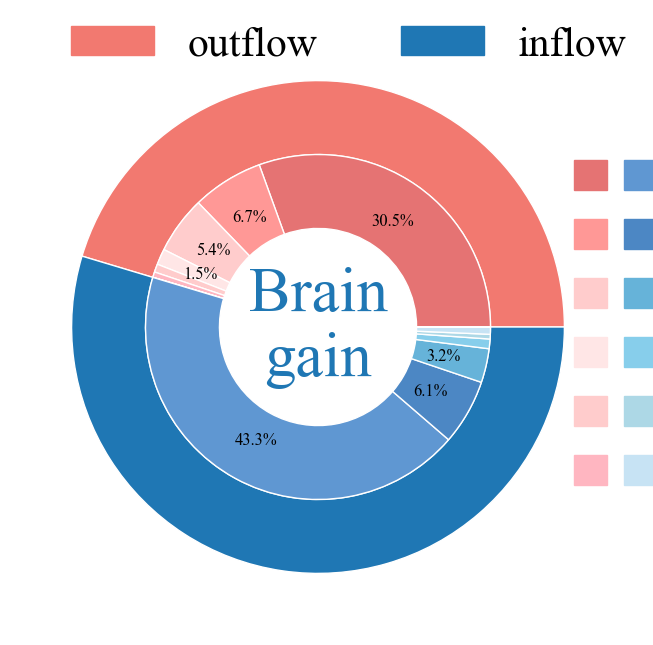

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.legend import Legend
import matplotlib.patches as mpatches
from matplotlib import font_manager
# 数据
vals = np.array([[55308, 12085, 9753, 2686, 1380, 932, 14], [78450, 11118, 5764, 1632, 793, 1222, 2]])
outer_labels = ['Category A', 'Category B']
inner_labels = ['North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other',
                'North America', 'Asia', 'Europe', 'Oceania', 'Africa', 'South America', 'Other']
# 手动指定颜色
outer_colors = ['#F27970', '#1f77b4']
inner_colors = ["#e57373", "#ff9896", "#ffcccc", "#ffe6e6", "#ffcccc", "#ffb6c1", "#ffa07a",
                "#5F97D2", "#4c87c4", "#66b3d9", "#87ceeb", "#add8e6", "#c7e3f4", "#d9f0f7"]

from matplotlib.legend_handler import HandlerLine2D, HandlerTuple
from matplotlib.patches import Patch
# Create color patches
# Create color patches for different groups
# Create the legend with multiple 'Two keys' stacked

# 自定义显示占比的函数，只有占比大于1%才显示标签
def func(pct, allvals):
    return f"{pct:.1f}%" if pct > 1 else ''

# 绘图
fig, ax = plt.subplots(figsize=(12, 8))  # 调整图形大小
size = 0.3

patch1 = Patch(color='#F27970') #流出
patch2 = Patch(color='#1f77b4') #流入

patch3 = Patch(color='#e57373') #North America
patch4 = Patch(color='#5F97D2')

patch5 = Patch(color='#ff9896') #Asia
patch6 = Patch(color='#4c87c4')

patch7 = Patch(color='#ffcccc') #Europe
patch8 = Patch(color='#66b3d9')

patch9 = Patch(color='#ffe6e6') #Oceania
patch10 = Patch(color='#87ceeb')

patch11 = Patch(color='#ffcccc') #Africa
patch12 = Patch(color='#add8e6')

patch13 = Patch(color='#ffb6c1') #South America
patch14 = Patch(color='#c7e3f4')

# font_prop = font_manager.FontProperties(size=40, color='white')

l = ax.legend([ (patch3, patch4),(patch5,patch6),(patch7,patch8),(patch9,patch10),(patch11,patch12),(patch13,patch14)], 
               ['North America','Asia','Europe','Oceania','Africa','South America'], 
               numpoints=1,
               bbox_to_anchor=(1.57, 0.5), # Position the legend
               loc='right',
               ncol=1,
               fontsize=30,  # 设置字体大小
               handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)

l2 = ax.legend([(patch1), (patch2)], 
               ['outflow', 'inflow'], 
               numpoints=1,
               bbox_to_anchor=(0.55, 1.05), # Position the legend
               loc='upper center',
               ncol=2,
               fontsize=30,  # 设置字体大小
               handler_map={tuple: HandlerTuple(ndivide=None)},frameon=False)
# 添加第一个图例
ax.add_artist(l)
# 设置统一颜色
for text in l.get_texts():
    text.set_color('black')  # 统一为绿色

# 外环
wedges_outer, texts_outer, autotexts_outer = ax.pie(
    vals.sum(axis=1),
    radius=1,
    # labels=outer_labels,
    colors=outer_colors,
    autopct='',  # 显示占比
    pctdistance=0.85,
    wedgeprops=dict(width=size, edgecolor='w'),
)

# 内环
wedges_inner, texts_inner, autotexts_inner = ax.pie(
    vals.flatten(),
    radius=1-size,
    # labels=inner_labels,
    colors=inner_colors,
    autopct=lambda pct: func(pct, vals.flatten()),  # 使用自定义的占比显示函数
    pctdistance=0.75,
    wedgeprops=dict(width=size, edgecolor='w')
)
# # 添加内圈的图例
# ax.legend(wedges_inner, inner_labels, loc="upper left", bbox_to_anchor=(1, 0, 0.5, 1),frameon=False)

# 在中心添加文本
ax.text(0, 0, 'Brain\ngain', ha='center', va='center', fontsize=45, color='#1f77b4')
# 美化文本
for autotext in autotexts_outer + autotexts_inner:
    autotext.set_color('black')
    autotext.set_fontsize(12)
plt.show()


Text(0.2751, 0.506, 'Brain circulation of USA')

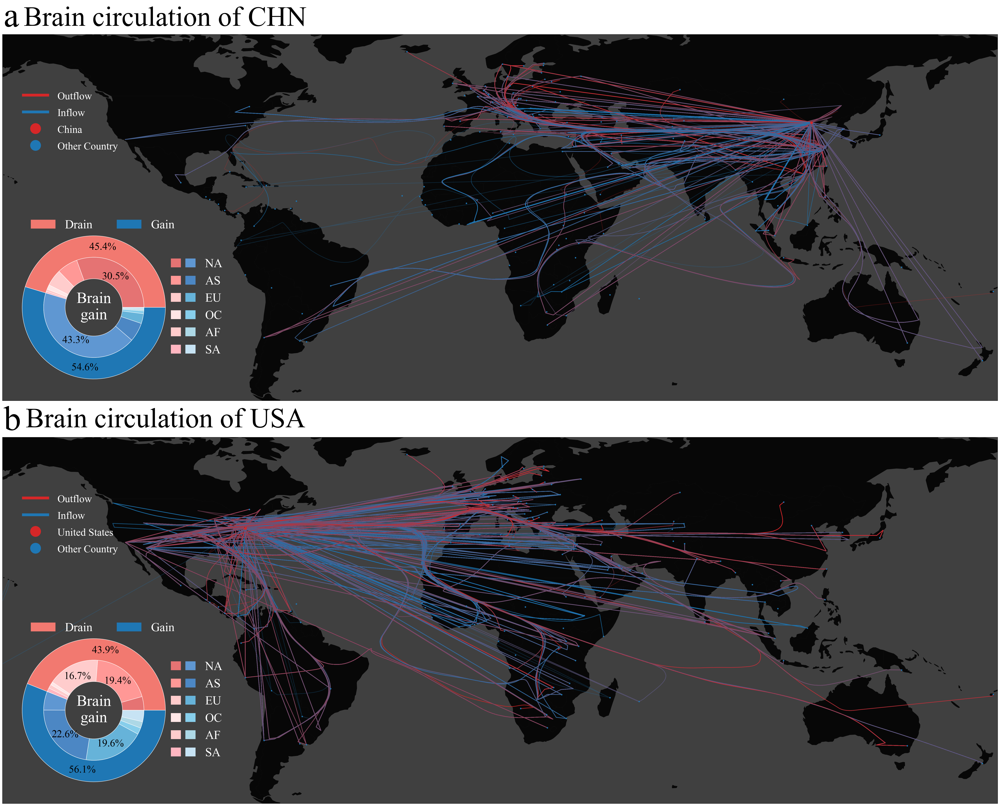

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl


plt.rcParams['figure.dpi'] = 150

fig, axs = plt.subplots(2,1, figsize=(80, 40))

# 调整子图之间的间距
plt.subplots_adjust(wspace=0.04, hspace=0.1)  # wspace 调整子图的水平间距，hspace 调整垂直间距

plotA(axs[0])
plotB(axs[1])

plt.savefig('output_image.svg', format='svg', bbox_inches='tight')

fig.text(0.2641, 0.912, 'a', fontsize=100, va='top', fontweight='bold', family = 'Times New Roman')
fig.text(0.2741, 0.908, 'Brain circulation of CHN', fontsize=80, va='top',family = 'Times New Roman')

fig.text(0.2641, 0.508, 'b', fontsize=100, va='top', fontweight='bold',family = 'Times New Roman')
fig.text(0.2751, 0.506, 'Brain circulation of USA', fontsize=80, va='top',family = 'Times New Roman')

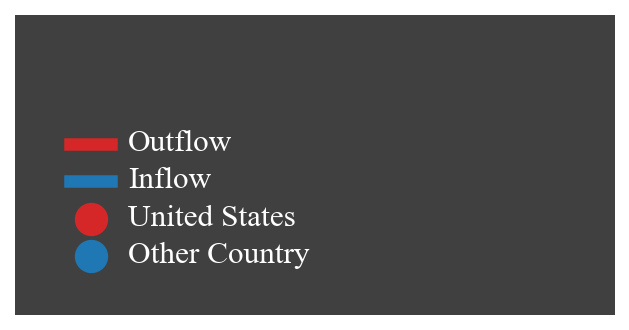

In [66]:
#画图例
fig, ax = plt.subplots(1,1, figsize=(4, 2))
target_name = 'United States'
# 创建虚拟点，表示图例
point_china = Line2D([0], [0], marker='o', color='#d62728', markersize=15, linestyle='None')  # 红色圆形代表China
point_other = Line2D([0], [0], marker='o', color='#1f77b4', markersize=15, linestyle='None')  # 蓝色圆形代表Other

# 创建虚拟线条，表示图例
line_outflow = Line2D([0], [0], color='#d62728', lw=6, linestyle='-')
line_inflow = Line2D([0], [0], color='#1f77b4', lw=6, linestyle='-')

# 将虚拟点和虚拟线条添加到legend中
legend_handles = [line_outflow, line_inflow,point_china, point_other, ]
legend_labels = ['Outflow', 'Inflow',target_name, 'Other Country']

# 添加虚拟点到图例
legend = ax.legend(legend_handles, legend_labels, loc='lower left', bbox_to_anchor=(0.06, 0.09), frameon=False, fontsize=10)

# 设置图例标签的字体样式
prop = fm.FontProperties(fname='/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')  # 创建FontProperties对象，设置字体样式为正常
for text in legend.get_texts():
    text.set_font_properties(prop)
    text.set_color('white')
    text.set_fontsize(15)

ax.set_xticks([])
ax.set_yticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_facecolor('#404040')  # 设置背景色为 #070707
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)  # 调整边距

[]

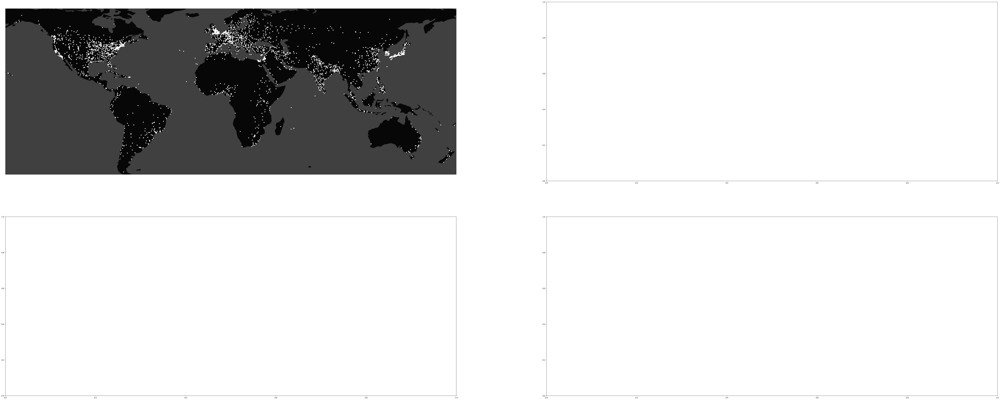

In [11]:

fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])
### panel a
ax.set_facecolor(fc)
gdf.plot(ax=ax, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),
         edgecolor='#070707')
ax.scatter(city_gdf_pa['Lng'].astype('float'),city_gdf_pa['Lat'].astype('float'),\
                    marker='o',color='white',s=15)

ax.set_xlim(-160,180)
ax.set_ylim(-55,70)
ax.set_xticks([])
ax.set_yticks([])



In [7]:
# fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])

# ### panel c
# ax1.set_facecolor(fc)
# gdf.plot(ax=ax1, column="continent", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
#          edgecolor='#070707')
# ax1.scatter(city_gdf_pt['Lng'].astype('float'),city_gdf_pt['Lat'].astype('float'),\
#                     marker='o',color='white',s=15)
# ax1.set_xlim(-160,180)
# ax1.set_ylim(-55,70)
# ax1.set_xticks([])
# ax1.set_yticks([])

alp = 0.25
lw_ = 1
cs = {
    'red':'#d62728',
    'blue':'#1f77b4'
}

fig, ax=plt.subplots(figsize=[160, 80])

### panel c
ax.set_facecolor(fc)
gdf.plot(ax=ax, column="continent", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
         edgecolor='#070707')
ax.scatter(city_gdf_pt['Lng'].astype('float'),city_gdf_pt['Lat'].astype('float'),\
                    marker='o',color='white',s=15)
ax.set_xlim(-160,180)
ax.set_ylim(-55,70)
ax.set_xticks([])
ax.set_yticks([])



[]

[]

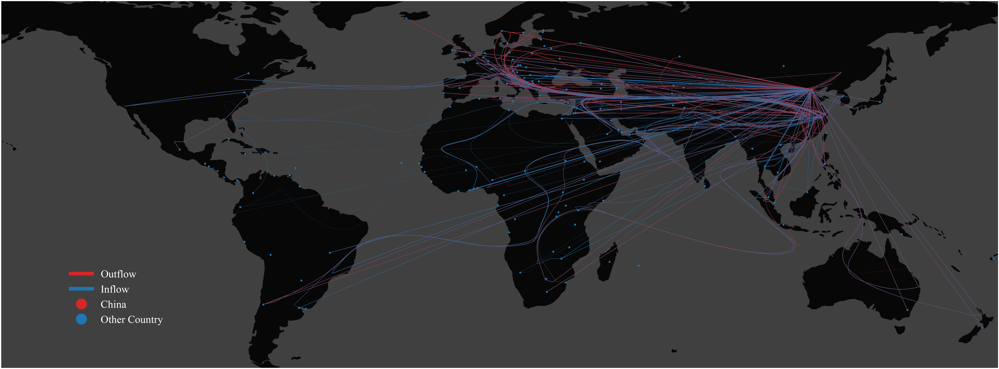

In [8]:
from scipy.interpolate import make_interp_spline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm

file_path = 'capital_location1.json'

location_shoudu = {}

with open(file_path, 'r') as json_file:
    for line in json_file:
        json_data = json.loads(line)

        country = json_data['country']
        location = json_data['location']

        location_shoudu[country] = location


origin = 'United States'
path = []

for item in capital_location:
    country = item['country']
    if country == 'China' :
        result_path = get_origin_destination_path(origin,country)
        # print(result_path[0])
        # print(result_path[1])
        if len(result_path) == 0:
            print(country)
        path.append(result_path)

# fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])
fig, ax2=plt.subplots(figsize=[100, 40])

# fig = plt.figure(figsize=[100, 40])
# ax = fig.add_subplot(111)
# ax.set_facecolor(fc)
### panel b
ax2.set_facecolor(fc)
gdf.plot(ax=ax2, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
         edgecolor='#070707')

#c是city 
# for c in DC:
#     if DC[c] == 'red':
#         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#d62728',s=40,zorder=100)
#     else:
#         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#1f77b4',s=40,zorder=100)

for key,location in location_shoudu.items():
    if key != "China":
        ax2.scatter(location[0],location[1],color='#1f77b4',s=100,zorder=100)
    else:
        ax2.scatter(location[0],location[1],color='#d62728',s=200,zorder=100)

path_origin = {}
path_destination = {}

alp = 0.25
lw_ = 1.8
cs = {
    'red':'#d62728',
    'blue':'#1f77b4'
}

# count = 0

for pair in city_path:

    country1 = pair[0].split('|')[2]
    country2 = pair[1].split('|')[2]
    if country1 == 'China':
        if country2 not in path_origin:
            path = get_origin_destination_path(country1,country2)
            path_origin[country2] = path
        # print(type(city_path[pair][0]))
        # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
        ax2.plot(path_origin[country2][0],path_origin[country2][1],color = '#d62728' ,zorder=1.5,lw=lw_,alpha=alp)
    if country2 == 'China':
        if country1 not in path_destination:
            path = get_origin_destination_path(country1,country2)
            path_destination[country1] = path
        # print(type(city_path[pair][0]))
        # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
        ax2.plot(path_destination[country1][0],path_destination[country1][1],color = '#1f77b4' ,zorder=1.5,lw=lw_,alpha=alp)
    # count = count + 1
    # if count == 200:
    #     break

colorslist = ['#DDEFB1','#FEF4C0','#FEEEBA','#FEE1AA','#FDC68A','#FBBB7F','#FBBA7E','#F5A374','#EF8F6B','#EB7547','#DF5952','#DC402D','#D83428']
mycmaps = colors.LinearSegmentedColormap.from_list('mylist',colorslist,N=100)
color_bin = np.arange(0,101,1)

# 创建虚拟点，表示图例
point_china = Line2D([0], [0], marker='o', color='#d62728', markersize=60, linestyle='None')  # 红色圆形代表China
point_other = Line2D([0], [0], marker='o', color='#1f77b4', markersize=60, linestyle='None')  # 蓝色圆形代表Other

# 创建虚拟线条，表示图例
line_outflow = Line2D([0], [0], color='#d62728', lw=20, linestyle='-')
line_inflow = Line2D([0], [0], color='#1f77b4', lw=20, linestyle='-')

# # 将虚拟点和虚拟线条添加到legend中
# legend_handles = [point_china, point_other, line_outflow, line_inflow]
# legend_labels = ['China', 'Other Country', 'Outflow', 'Inflow']

# 将虚拟点和虚拟线条添加到legend中
legend_handles = [line_outflow, line_inflow,point_china, point_other, ]
legend_labels = ['Outflow', 'Inflow','China', 'Other Country']

# 添加虚拟点到图例
legend = ax2.legend(legend_handles, legend_labels, loc='lower left', bbox_to_anchor=(0.06, 0.09), frameon=False, fontsize=60)

# 设置图例标签的字体样式
prop = fm.FontProperties(fname='/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')  # 创建FontProperties对象，设置字体样式为正常
for text in legend.get_texts():
    text.set_font_properties(prop)
    text.set_color('white')
    text.set_fontsize(60)

ax2.set_xlim(-160,180)
ax2.set_ylim(-55,70)
ax2.set_xticks([])
ax2.set_yticks([])


[]

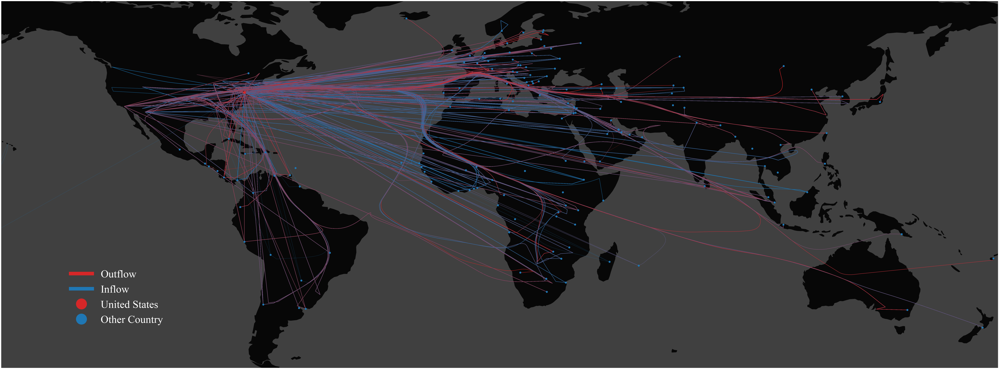

In [13]:
#做一个美国的

from scipy.interpolate import make_interp_spline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm

file_path = 'capital_location1.json'

location_shoudu = {}

with open(file_path, 'r') as json_file:
    for line in json_file:
        json_data = json.loads(line)

        country = json_data['country']
        location = json_data['location']

        location_shoudu[country] = location


origin = 'United States'
path = []

for item in capital_location:
    country = item['country']
    if country == 'China' :
        result_path = get_origin_destination_path(origin,country)
        # print(result_path[0])
        # print(result_path[1])
        if len(result_path) == 0:
            print(country)
        path.append(result_path)

# fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])
fig, ax2=plt.subplots(figsize=[100, 40])

# fig = plt.figure(figsize=[100, 40])
# ax = fig.add_subplot(111)
# ax.set_facecolor(fc)
### panel b
ax2.set_facecolor(fc)
gdf.plot(ax=ax2, column="CONTINENT", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
         edgecolor='#070707')

#c是city 
# for c in DC:
#     if DC[c] == 'red':
#         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#d62728',s=40,zorder=100)
#     else:
#         ax2.scatter(CL_paper[c][0],CL_paper[c][1],color='#1f77b4',s=40,zorder=100)

for key,location in location_shoudu.items():
    if key != "United States":
        ax2.scatter(location[0],location[1],color='#1f77b4',s=100,zorder=100)
    else:
        ax2.scatter(location[0],location[1],color='#d62728',s=200,zorder=100)

path_origin = {}
path_destination = {}

alp = 0.25
lw_ = 1.8
cs = {
    'red':'#d62728',
    'blue':'#1f77b4'
}

# count = 0

for pair in city_path:

    country1 = pair[0].split('|')[2]
    country2 = pair[1].split('|')[2]
    if country1 == 'United States':
        if country2 not in path_origin:
            path = get_origin_destination_path(country1,country2)
            path_origin[country2] = path
        # print(type(city_path[pair][0]))
        # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
        ax2.plot(path_origin[country2][0],path_origin[country2][1],color = '#d62728' ,zorder=1.5,lw=lw_,alpha=alp)
    if country2 == 'United States':
        if country1 not in path_destination:
            path = get_origin_destination_path(country1,country2)
            path_destination[country1] = path
        # print(type(city_path[pair][0]))
        # ax2.plot(city_path[pair][0],city_path[pair][1],color = cs[EC[pair]],zorder=1,lw=lw_,alpha=alp)
        ax2.plot(path_destination[country1][0],path_destination[country1][1],color = '#1f77b4' ,zorder=1.5,lw=lw_,alpha=alp)
    # count = count + 1
    # if count == 200:
    #     break

colorslist = ['#DDEFB1','#FEF4C0','#FEEEBA','#FEE1AA','#FDC68A','#FBBB7F','#FBBA7E','#F5A374','#EF8F6B','#EB7547','#DF5952','#DC402D','#D83428']
mycmaps = colors.LinearSegmentedColormap.from_list('mylist',colorslist,N=100)
color_bin = np.arange(0,101,1)


# ax2.scatter(-150, -30, color='red', label='China', s=200)  # 红色圆形代表China
# ax2.scatter(0, 1, color='blue', label='Other Country', s =200)  # 蓝色圆形代表Other Country

# # 创建虚拟点，表示图例
# point_china = Line2D([0], [0], marker='o', color='red', markersize=60, linestyle='None')  # 红色圆形代表China
# point_other = Line2D([0], [0], marker='o', color='blue', markersize=60, linestyle='None')  # 蓝色圆形代表Other

# # 添加虚拟点到图例
# legend = ax2.legend([point_china, point_other], ['China', 'Other Country'], loc='lower left',bbox_to_anchor=(0.10, 0.05), frameon=False, fontsize=60)

# prop = fm.FontProperties(style='normal')  # 创建FontProperties对象，设置字体样式为斜体

# for text in legend.get_texts():
#     text.set_font_properties(prop)
#     text.set_color('white')
#     text.set_fontsize(60)

# # 创建虚拟线条，表示图例
# line_outflow = Line2D([0], [0], color='#d62728', lw=20, linestyle='-')
# line_inflow = Line2D([0], [0], color='#1f77b4', lw=20, linestyle='-')

# # 添加虚拟线条到图例
# legend = ax2.legend([line_outflow, line_inflow], ['Outflow', 'Inflow'], loc='lower left', bbox_to_anchor=(0.10, 0.03), frameon=False,fontsize=60)

# 创建虚拟点，表示图例
point_china = Line2D([0], [0], marker='o', color='#d62728', markersize=60, linestyle='None')  # 红色圆形代表China
point_other = Line2D([0], [0], marker='o', color='#1f77b4', markersize=60, linestyle='None')  # 蓝色圆形代表Other

# 创建虚拟线条，表示图例
line_outflow = Line2D([0], [0], color='#d62728', lw=20, linestyle='-')
line_inflow = Line2D([0], [0], color='#1f77b4', lw=20, linestyle='-')

# # 将虚拟点和虚拟线条添加到legend中
# legend_handles = [point_china, point_other, line_outflow, line_inflow]
# legend_labels = ['China', 'Other Country', 'Outflow', 'Inflow']

# 将虚拟点和虚拟线条添加到legend中
legend_handles = [line_outflow, line_inflow,point_china, point_other, ]
legend_labels = ['Outflow', 'Inflow','United States', 'Other Country']

# 添加虚拟点到图例
legend = ax2.legend(legend_handles, legend_labels, loc='lower left', bbox_to_anchor=(0.06, 0.09), frameon=False, fontsize=60)

# 设置图例标签的字体样式
prop = fm.FontProperties(fname='/home/qiuyang/workplace/world_map_drawing/Geographical heterogeneity/Geomap/bokeh-app/data/font/times.ttf')  # 创建FontProperties对象，设置字体样式为正常
for text in legend.get_texts():
    text.set_font_properties(prop)
    text.set_color('white')
    text.set_fontsize(60)

ax2.set_xlim(-160,180)
ax2.set_ylim(-55,70)
ax2.set_xticks([])
ax2.set_yticks([])


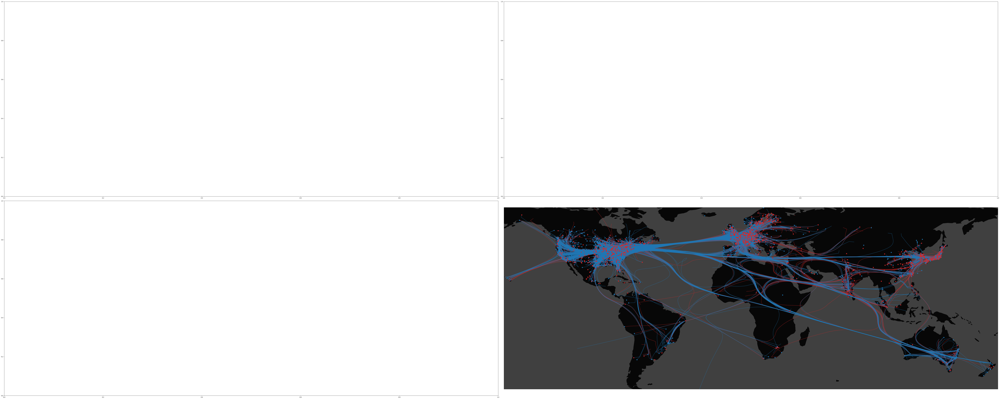

In [6]:
fig, ((ax,ax2),(ax1,ax3))=plt.subplots(2,2,figsize=[100, 40])

### panel d
ax3.set_facecolor(fc)
gdf.plot(ax=ax3, column="continent", legend=False, cmap=colors.ListedColormap(list(color_dict.values())),\
         edgecolor='#070707')
for c in DC_pt:
    if DC_pt[c] == 'red':
        ax3.scatter(CL_patent[c][0],CL_patent[c][1],color='#d62728',s=40,zorder=100)
    else:
        ax3.scatter(CL_patent[c][0],CL_patent[c][1],color='#1f77b4',s=40,zorder=100)
for pair in city_path_pt:
    if pair in main_city_pt:
        ax3.plot(city_path_pt[pair][0],city_path_pt[pair][1],color = cs[EC_pt[pair]],zorder=1,lw=lw_,alpha=alp)
        continue
    if random.random()>0.99:
        ax3.plot(city_path_pt[pair][0],city_path_pt[pair][1],color = cs[EC_pt[pair]],zorder=1,lw=lw_,alpha=alp)
ax3.set_xlim(-160,180)
ax3.set_ylim(-55,70)
ax3.set_xticks([])
ax3.set_yticks([])

plt.tight_layout()
plt.show()

In [21]:
def curvature(x, y):
    total_curvature = 0
    for i in range(len(x) - 1):
        dx = x[i + 1] - x[i]
        dy = y[i + 1] - y[i]
        if dx != 0:
            slope = dy / dx
            total_curvature += abs(slope)
    return total_curvature

# 示例坐标数组
x = np.array([ 1, 1.2, 1.3, 1.4])
y = np.array([ 1, 1.2, 1.3, 1.4])

# 计算曲率
curv = curvature(x, y)
print("曲率度量:", curv)

曲率度量: 5.000000000000004


NameError: name 'Line2D' is not defined

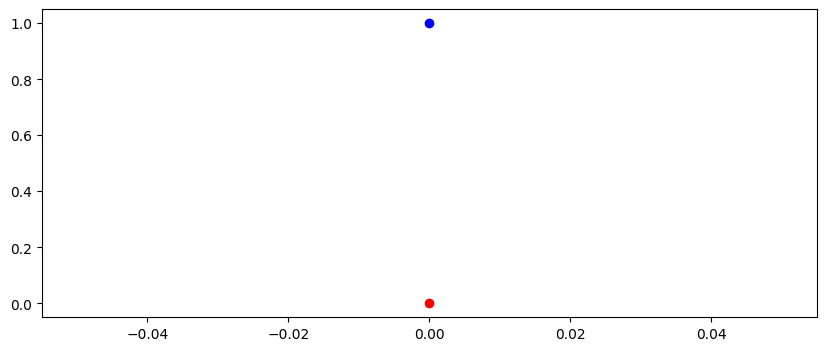

In [6]:
import matplotlib.pyplot as plt

# 创建图和坐标轴
fig, ax = plt.subplots(figsize=[10, 4])

# 绘制数据
# 这里使用scatter和plot函数简单示例
# 你可以根据自己的数据类型选择合适的绘图函数和参数

# ax.plot([0, 1], [1, 0], color='red', label='Outflow')  # 红线代表outflow
# ax.plot([0, 1], [0, 1], color='blue', label='Inflow')  # 蓝线代表inflow
# 创建虚拟线条，表示流入和流出
# line_outflow = Line2D([0], [0], color='red', lw=2, linestyle='-')  # 红线代表outflow
# line_inflow = Line2D([0], [0], color='blue', lw=2, linestyle='-')  # 蓝线代表inflow

# 添加虚拟线条到图例
ax.legend([line_outflow, line_inflow], ['Outflow', 'Inflow'], loc='lower left')
# 设置图例位置为左下角
ax.legend(loc='lower left')

plt.show()